# working with C2L outputs, Loading and working with processed Visium data Paediatric

In [1]:
import numpy as np
import scipy as sp
import scanpy as sc
import pandas as pd
import pickle as pkl
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import re
import os
import scipy.stats
from numpy import asarray as ar
from collections import Counter
import scvi
import imagespot_rev_v1 as ims
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100
from datetime import date
today = str(date.today())
sc.settings.verbosity = 1
sc.logging.print_version_and_date()
%load_ext autoreload
%autoreload 2

Global seed set to 0
/nfs/team205/ny1/miniconda/miniconda3/envs/scvi-env/lib/python3.9/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/nfs/team205/ny1/miniconda/miniconda3/envs/scvi-env/lib/python3.9/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


Running Scanpy 1.9.1, on 2024-07-02 14:18.


In [2]:
## For correct plotting of the images
from matplotlib import font_manager
font_manager.fontManager.addfont("")
# print(font_manager.findfont("Arial"))
plt.rcParams["font.sans-serif"] = ["Arial"]
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

In [3]:
# output folder 
import os
# os.getcwd()

In [4]:
# load raw unified object 
adata_paed_all = sc.read_h5ad('')
del adata_paed_all.obs['cma_v1'] # remove old axis 
# adata_paed_all

# QC 

In [5]:
# filter spots by coverage
adata_paed_filt = adata_paed_all.copy()
sc.pp.filter_genes(adata_paed_filt,min_counts=2) # retain at least 3 levels of expression 0,1,2
adata_paed_filt.layers['counts'] = adata_paed_filt.X
adata_paed_filt = adata_paed_filt[adata_paed_filt.obs['tot_cell_abundance']>25,:].copy()
adata_paed_filt = adata_paed_filt[adata_paed_filt.obs['n_genes_by_counts']>1000,:]
adata_paed_filt = adata_paed_filt[adata_paed_filt.obs['annotations_level_0']!='Artifacts']
adata_paed_filt = adata_paed_filt[adata_paed_filt.obs['annotations_level_0']!='Background']
adata_paed_filt = adata_paed_filt[adata_paed_filt.obs['annotations_level_0']!='unassigned']
adata_paed_filt = adata_paed_filt[adata_paed_filt.obs['annotations_level_0']!='Unassigned']
adata_paed_filt.obs['annotations_level_1'] = adata_paed_filt.obs['annotations_level_1'].astype('object')
adata_paed_filt.obs.loc[adata_paed_filt.obs['annotations_level_1']=='HS','annotations_level_1'] = 'HC'
adata_paed_filt.obs['annotations_level_1'] = adata_paed_filt.obs['annotations_level_1'].astype('category')

adata_paed_filt = adata_paed_filt[~adata_paed_filt.obs['annotations_level_0'].isna()]

del adata_paed_all
# adata_paed_filt

# fix colors

In [6]:
adata_paed_filt.obs['annotations_level_1'] = adata_paed_filt.obs['annotations_level_1'].astype('object')
adata_paed_filt.obs.loc[adata_paed_filt.obs['annotations_level_1']=='HS','annotations_level_1'] = 'HC'
adata_paed_filt.obs['annotations_level_1'] = adata_paed_filt.obs['annotations_level_1'].astype('category')

In [7]:

htsa_colors = pd.read_csv('')
htsa_colors = htsa_colors.append({'structure': 'Fat', 'color_names': 'Cyclamen', 'color_map': '#ff6699'}, ignore_index=True)
htsa_colors = htsa_colors.set_index('structure')
htsa_colors

# map the colors to the categories
categories = adata_paed_filt.obs['annotations_level_0'].cat.categories
colors = []
for cat in categories:
    try:
        colors.append(htsa_colors['color_map'][cat])
    except KeyError:  # cat is not found in colors_dict
        colors.append('gray')  # use a default color

# assign the colors
adata_paed_filt.uns['annotations_level_0_colors'] = colors

# map the colors to the categories
categories = adata_paed_filt.obs['annotations_level_1'].cat.categories

colors = []
for cat in categories:
    try:
        colors.append(htsa_colors['color_map'][cat])
    except KeyError:  # cat is not found in colors_dict
        colors.append('gray')  # use a default color

# assign the colors
adata_paed_filt.uns['annotations_level_1_colors'] = colors

,color_names,color_map
structure,,
Artifacts,Cyclamen,#ff6699
lymph,Dark grey,#505050
Medulla,Orange peel,#ff9900
Edge,Duke blue,#330099
Cortex,Blue Green,#0099cc
HC,Forest green,#009900
PVS,Mauveine,#990099
vessels,Yellow,#ffff00
Fat,Cyclamen,#ff6699


# plot individual sample composition in umap and PCA space 

In [8]:
os.chdir('')
sc.set_figure_params(figsize=[4,4],fontsize=10,dpi=100)
for s in np.unique(adata_paed_filt.obs['SampleID']):
    adata = adata_paed_filt[adata_paed_filt.obs['SampleID']==s].copy()
    sc.pp.normalize_total(adata)
    sc.pp.log1p(adata)
    sc.pp.neighbors(adata)
    sc.tl.umap(adata)
#     sc.pl.umap(adata, color = ['cma_v2','annotations_level_0','annotations_level_1']
#            , title = s, frameon = False, cmap = 'gist_rainbow',save='_paed_sample_id'+s+'.pdf',s=40,vmin=-0.8,vmax=0.8)

In [9]:
sc.set_figure_params(figsize=[4,4],fontsize=10,dpi=100)
cumul_pca = {}
for s in np.unique(adata_paed_filt.obs['SampleID']):
    adata = adata_paed_filt[adata_paed_filt.obs['SampleID']==s].copy()
    sc.pp.normalize_per_cell(adata)
    sc.pp.log1p(adata)
    sc.pp.pca(adata)
    # sc.pl.pca(adata, color = ['cma_v2','annotations_level_0','annotations_level_1']
    #        , title = s, frameon = False, cmap = 'gist_rainbow',save='_fet_sample_id'+s+'.pdf',s=40,vmin=-0.8,vmax=0.8)
    cumul_pca[s] = ims.cumulative_pca(adata,obs='cma_v2',ncomps=10)


In [12]:
# Convert cumul_pca to a DataFrame, calculate the metric
sample_info = adata_paed_filt.obs[['SampleID', 'Age(numeric)', 'DonorID']].drop_duplicates().set_index('SampleID')

df_pca = pd.DataFrame(cumul_pca).T  # Transpose to have samples as rows
df_pca['Metric'] = df_pca.sum(axis=1) / 10  # Calculate the sum or average of your metrics for each sample

# Merge the PCA metrics with the sample information
df_merged = df_pca.merge(sample_info, left_index=True, right_index=True)
df_sorted = df_merged.sort_values(by=['Age(numeric)', 'DonorID'])
df_sorted.index = df_sorted.index.astype(str)

df_sorted['Age(numeric)'] = (df_sorted['Age(numeric)']).astype(str)
df_sorted['DonorID'] = df_sorted['DonorID'].astype(str)

# df_sorted['PlotLabel'] = 'Sample ID: '+ df_sorted.index + ' | Age (PCW): ' + df_sorted['Age(numeric)'] + ' | Donor: ' + df_sorted['DonorID']

plt.figure(figsize=(12, 8))
# plt.bar(df_sorted['PlotLabel'], height=df_sorted['Metric'])
plt.xticks(rotation=90)
plt.xlabel('Sample ID | Age (months) | Donor ID')
plt.ylabel('Average Metric')
plt.title('Sample Variability by Age and Donor')
plt.tight_layout()
plt.ylim(0,60)
plt.savefig('figures/PCA_Paed_sample_variability_plot.pdf')


plt.show()

In [13]:
df_sorted.to_csv('')

# SCVI 

In [54]:
adata_tmp = adata_paed_filt.copy()
cc_genes =  ['C1orf112', 'KDM1A', 'ARHGAP33', 'CDC27', 'AC004381.6', 'DBF4', 'PRSS21', 'E2F2', 'BAZ1B', 'NCAPD2', 'ANLN', 'BRCA1', 'UBR7', 'DDX11', 'TACC3', 'POLA2', 'DEPDC1', 'NCAPH2', 'HMGB3', 'CENPQ', 'DEPDC1B', 'SPDL1', 'TDP1', 'DSG2', 'NOP16', 'RFC2', 'RAD51', 'POLQ', 'THOC3', 'MRTO4', 'C4orf27', 'POLD1', 'TM7SF3', 'MCM10', 'MTHFD2', 'YBX1', 'ASPM', 'PRR11', 'NUCKS1', 'EXOC5', 'TCOF1', 'RAD18', 'TRIP13', 'DAZAP1', 'HLTF', 'PDCD2', 'SMC1A', 'HMMR', 'MCM2', 'NUP37', 'GTSE1', 'WDR62', 'MCM6', 'MLH1', 'UNG', 'SPAG5', 'UBE2T', 'EXOSC5', 'FAM76B', 'POLD3', 'KIF22', 'PUM3', 'RBL1', 'NDC80', 'HSPB11', 'OXCT1', 'SEH1L', 'ORC1', 'RAD54L', 'NOP14', 'GMCL1', 'AURKA', 'TPX2', 'BIRC5', 'KIF4A', 'FH', 'ORC6', 'G2E3', 'WDR76', 'PHGDH', 'CLSPN', 'NUP50', 'CDC45', 'CDC6', 'CBX5', 'MSH2', 'FKBP5', 'ACOT7', 'CDC7', 'RANBP1', 'CENPM', 'HMGXB4', 'MCM5', 'RANGAP1', 'POLE2', 'CDKN3', 'ERH', 'MTHFD1', 'VRK1', 'EMC9', 'GINS1', 'MYBL2', 'CDC25B', 'PLCB4', 'FAM83D', 'CEP76', 'RBBP8', 'POLA1', 'NUP93', 'CTCF', 'CCP110', 'CEP152', 'OIP5', 'MYEF2', 'MCM4', 'KCTD9', 'RNASEH2A', 'SGTA', 'ASF1B', 'LIG1', 'H2AFV', 'GARS', 'NUDT1', 'RPA3', 'EZH2', 'RHEB', 'SMC3', 'UBE2S', 'RAD51C', 'GALK1', 'C1QBP', 'BLMH', 'TMEM97', 'GAR1', 'NEIL3', 'WHSC1', 'NCAPG', 'CCDC34', 'CCDC86', 'MAGOHB', 'FOXM1', 'GPN3', 'RAD51AP1', 'RFC5', 'NUP107', 'TIMELESS', 'GAPDH', 'CDCA3', 'ENO2', 'FBXO5', 'MCM3', 'BAG2', 'GMNN', 'TTK', 'HMGCS1', 'BRD8', 'KIF20A', 'LMNB1', 'NUP155', 'H2AFY', 'SMC4', 'ECT2', 'CENPA', 'FHL2', 'MSH6', 'DHCR24', 'LRRC42', 'WDR77', 'SRM', 'MAD2L2', 'UCHL5', 'TTF2', 'SLC2A1', 'EBNA1BP2', 'CDC20', 'STMN1', 'NEK2', 'CENPF', 'KIF14', 'CASP8AP2', 'CTNNAL1', 'WDR34', 'PHF19', 'ACYP1', 'EPCAM', 'HELLS', 'CENPL', 'ACAT2', 'MASTL', 'EXOSC8', 'TMPO', 'NFYB', 'NCAPH', 'MND1', 'KIF18A', 'GPSM2', 'GTF3A', 'MRPS2', 'CCDC18', 'CISD1', 'ZWINT', 'CIT', 'DDX39A', 'CENPK', 'CDK2', 'TUBA1B', 'STIL', 'HJURP', 'EXOSC9', 'CKS2', 'ACSL3', 'CSE1L', 'HIST1H1D', 'HIST1H1A', 'DEK', 'GOT2', 'MGME1', 'MCM8', 'HNRNPR', 'BCL2L12', 'TRAP1', 'DLGAP5', 'YEATS4', 'PKMYT1', 'SRD5A3', 'PAICS', 'HAT1', 'KNSTRN', 'DUT', 'E2F8', 'FAM64A', 'MIS18BP1', 'SGOL1', 'RPS4Y1', 'LDLR', 'TOMM40', 'ATP8B3', 'LSM4', 'DNMT1', 'GINS2', 'TUBG1', 'PSMC3IP', 'THOC6', 'TOP2A', 'ENOSF1', 'RAN', 'RPA1', 'PCNA', 'NASP', 'RFC3', 'SLF1', 'LRRCC1', 'CCNB1', 'PSRC1', 'TMEM106C', 'LDHA', 'DDB2', 'CDCA8', 'TPGS2', 'SLC43A3', 'C9orf40', 'TROAP', 'ESPL1', 'NTPCR', 'CKAP2', 'BORA', 'NUDT15', 'BRIP1', 'ACTL6A', 'TXN', 'ODF2', 'SMC2', 'CDK5RAP2', 'ANP32B', 'DSCC1', 'ARHGEF39', 'PPIL1', 'TCF19', 'NRM', 'GGH', 'BUD13', 'CTDSPL2', 'NUSAP1', 'KIF23', 'CASC5', 'CENPO', 'KIF11', 'CEP55', 'KIF20B', 'DNA2', 'BARD1', 'MNS1', 'ZGRF1', 'CENPE', 'HADH', 'SLC39A8', 'NEDD1', 'BRCA2', 'DIAPH3', 'PIF1', 'FANCI', 'TICRR', 'SAMD1', 'SAE1', 'PLK4', 'ITGB3BP', 'KIF2C', 'UCK2', 'NUF2', 'ANP32E', 'DTL', 'ILF2', 'C1orf35', 'HNRNPLL', 'CHAC2', 'POLR2D', 'CDCA7', 'FANCD2', 'CCNA2', 'SKP2', 'PRIM2', 'MMS22L', 'PM20D2', 'MTFR2', 'CDCA5', 'NCAPG2', 'PRPS1', 'GINS4', 'HAUS6', 'CEP78', 'GTF3C5', 'MKI67', 'IMMP1L', 'SSRP1', 'INCENP', 'CCDC15', 'CHEK1', 'DSN1', 'HIRIP3', 'HMGA2', 'TEX30', 'NCAPD3', 'CENPU', 'CENPJ', 'SPC25', 'SUV39H2', 'CENPH', 'CARHSP1', 'CLGN', 'CCSAP', 'BUB3', 'SLFN13', 'SKA1', 'SLC16A1', 'TMEM237', 'ADK', 'FAM122B', 'AIFM1', 'ATAD2', 'SASS6', 'BUB1B', 'CCNB2', 'PSMG3', 'FAIM', 'CDC25C', 'MIS18A', 'ATP5G1', 'IGF2BP1', 'CHAF1B', 'NAE1', 'CCDC58', 'C21orf58', 'ZNF714', 'GPATCH4', 'YDJC', 'RACGAP1', 'SPC24', 'POLR3K', 'CCNF', 'ASRGL1', 'USP1', 'KIAA1524', 'SGOL2', 'TOPBP1', 'KIF15', 'WDR43', 'RFC4', 'RPL39L', 'RNF168', 'H2AFZ', 'CDC25A', 'POC1A', 'HMGB2', 'MAD2L1', 'PTTG1', 'RAD21', 'PSIP1', 'GKAP1', 'MELK', 'SLC7A3', 'SKA3', 'LRR1', 'HPRT1', 'E2F7', 'JAM3', 'BRD7', 'CENPN', 'LEO1', 'WEE1', 'MCM7', 'CENPV', 'SAAL1', 'FAM111A', 'KIAA0101', 'PLK1', 'XRCC6BP1', 'SNRPD1', 'RRM1', 'CDT1', 'CHAF1A', 'C19orf48', 'NUDT8', 'PRDX2', 'TK1', 'SAC3D1', 'PBK', 'HIST1H1E', 'DTYMK', 'RFWD3', 'FEN1', 'ING2', 'CDKN2AIP', 'SNRNP48', 'USP39', 'CKAP2L', 'BUB1', 'ELP5', 'CDK1', 'CDCA4', 'SHCBP1', 'PGAM1', 'ESCO2', 'RHNO1', 'CTPS1', 'RRM2', 'THOP1', 'C5orf34', 'POP7', 'ZNF738', 'CKS1B', 'GMPPB', 'CNP', 'CBX2', 'C16orf91', 'EXO1', 'ZWILCH', 'ANKRD36C', 'UBE2C', 'CKAP5', 'CCNE2', 'CCDC14', 'RMI2', 'TOMM5', 'RUVBL1', 'ATAD5', 'LMNB2', 'TYMS', 'PXMP2', 'SHMT1', 'POLE', 'PAWR', 'PIDD1', 'GSG2', 'GEN1', 'RMI1', 'AURKB', 'RCC1', 'PPA1', 'HIST3H2A', 'MRPS23', 'RTKN2', 'IDH2', 'KPNA2', 'CEP97', 'GLRX5', 'SKA2', 'CEP57L1', 'PSMG1', 'SFXN4', 'ALYREF', 'TRAIP', 'LIN9', 'KMT5A', 'PGP', 'CMSS1', 'HIST2H2AC', 'HIST1H1B', 'KNTC1', 'CDCA2', 'H1FX', 'SIVA1', 'PARPBP', 'KIF18B', 'ERCC6L', 'PTMA', 'HSPA14', 'FANCA', 'ARHGAP11B', 'TUBB4B', 'CENPP', 'H2AFX', 'FAM72B', 'FAM221A', 'FAM111B', 'HN1', 'HMGB1', 'TUBB', 'IARS', 'ERI2', 'HIST1H4C', 'BLM', 'PRIM1', 'HMGN5', 'SVIP', 'TFDP1', 'TXNRD1', 'WDHD1', 'EIF1AY', 'ARHGAP11A', 'HMGN2', 'DCAF12', 'PRC1', 'CCDC167', 'CENPW', 'GPANK1', 'MZT1', 'C4orf46', 'KLHL23', 'MXD3', 'DNAJC9', 'IFRD2', 'CKLF', 'FANCG', 'DHFR', 'DLEU2', 'AP000251.3', 'KIFC1', 'CRNDE', 'C8orf88', 'PRKDC', 'BOP1', 'RP11-196G18.23', 'CTC-260E6.6', 'NCBP2-AS2', 'HIST1H3G', 'HIST1H2AH', 'UHRF1', 'RDM1', 'HIST1H2AM']
def remove_selected_genes(adata,lst,remove_also_mt=True):
    for g in lst:
        adata = adata[:,~(adata.var_names==g)]
    if remove_also_mt:
        adata = adata[:,~(adata.var_names.str.startswith('MT-'))]
    return adata

adata_tmp = remove_selected_genes(adata_tmp,cc_genes,remove_also_mt=True)  

sc.pp.highly_variable_genes(
        adata_tmp,
        n_top_genes=3500,
        subset=True,
        layer='counts',
        flavor="seurat_v3",
        batch_key='SampleID',
        span=1,
    )
import re

for i in adata_tmp.var.index:
    if re.search('^TR[AB][VDJ]|^IG[HKL][VDJC]', i):
        adata_tmp.var.at[i, 'highly_variable'] = False
adata_tmp = adata_tmp[:,adata_tmp.var.highly_variable]
    

/nfs/team205/ny1/miniconda/miniconda3/envs/scvi-env/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


In [55]:
adata_tmp = adata_tmp.copy()
import warnings
warnings.filterwarnings('once')
scvi.model.SCVI.setup_anndata(adata_tmp, batch_key='DonorID', \
                        categorical_covariate_keys=['SlideID','Spaceranger','section_thickness (um)'],continuous_covariate_keys=['Age(numeric)','n_genes_by_counts'])
vae = scvi.model.SCVI(adata_tmp,n_layers=2, n_latent=30)
vae.train(max_epochs=300,batch_size=2000)
adata_paed_filt.obsm["X_scVI"] = vae.get_latent_representation() # return batch corrections to original anndata

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 300/300: 100%|███████████████████████████████████████████████| 300/300 [02:34<00:00,  1.92it/s, loss=741, v_num=1]

`Trainer.fit` stopped: `max_epochs=300` reached.


Epoch 300/300: 100%|███████████████████████████████████████████████| 300/300 [02:34<00:00,  1.94it/s, loss=741, v_num=1]


In [66]:
sc.pp.neighbors(adata_paed_filt, use_rep="X_scVI", n_neighbors=5)

In [113]:
sc.tl.umap(adata_paed_filt, min_dist = 0.1, spread = 1,n_components=3)

In [5]:
os.chdir('')

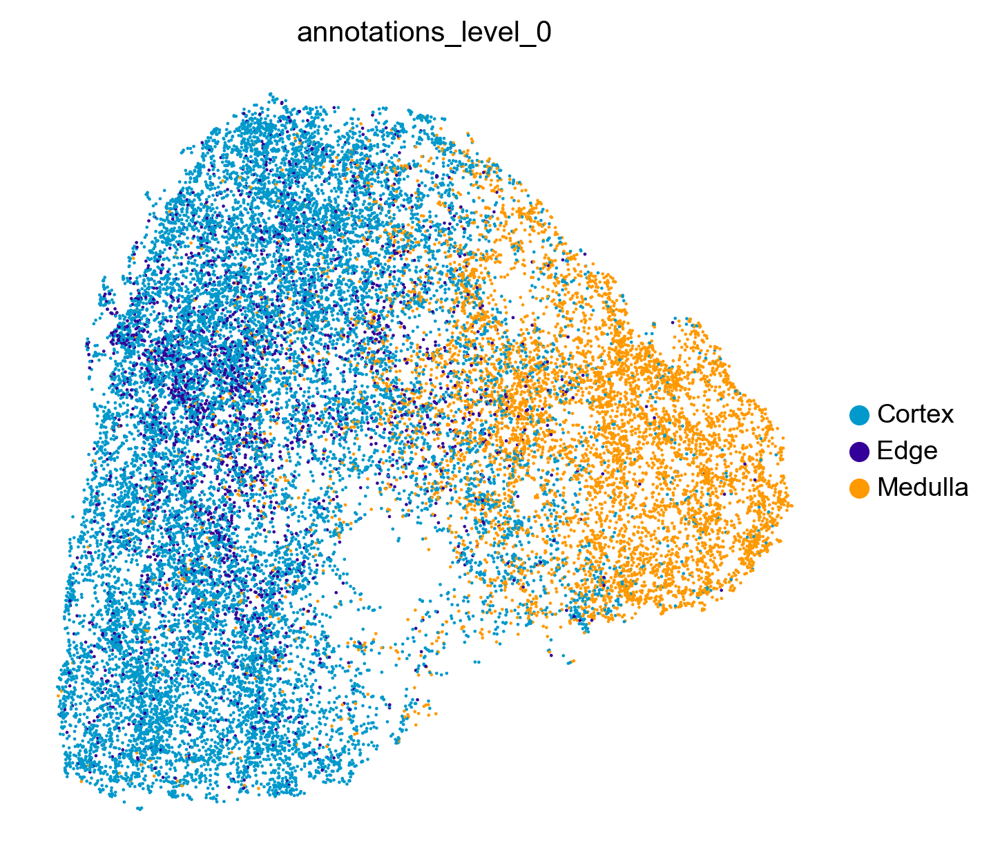

In [121]:
sc.pl.umap(adata_paed_filt, color = ['annotations_level_0']
           , frameon = False,s=5,save='_paed_annotations_level_0_v11.pdf')

/nfs/team205/ny1/miniconda/miniconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/nfs/team205/ny1/miniconda/miniconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:444: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  pl.colorbar(cax, ax=ax, pad=0.01, fraction=0.08, aspect=30)


/nfs/team205/ny1/miniconda/miniconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:444: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  pl.colorbar(cax, ax=ax, pad=0.01, fraction=0.08, aspect=30)


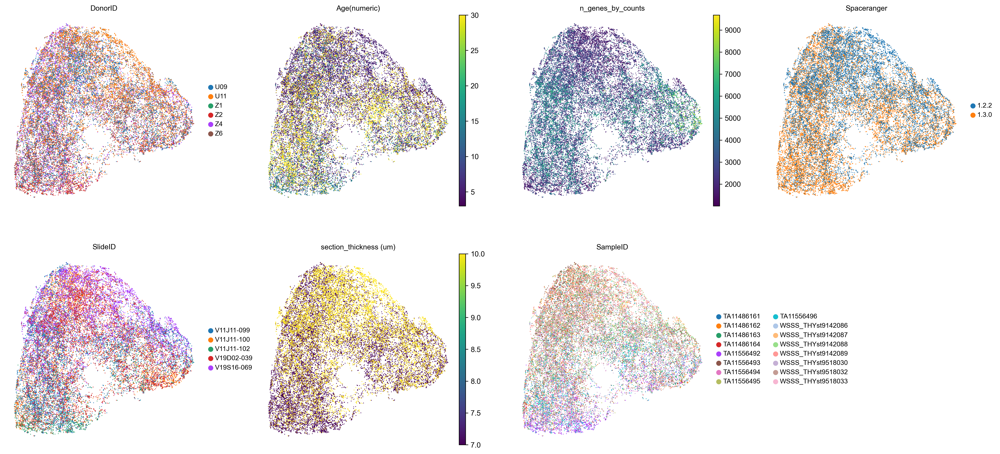

In [122]:
sc.set_figure_params(figsize=[5,5],fontsize=10,dpi=150)
sc.pl.umap(adata_paed_filt, color = ['DonorID','Age(numeric)','n_genes_by_counts','Spaceranger','SlideID','section_thickness (um)','SampleID']
           , frameon = False, cmap = 'viridis',save='_paed_meta_data_v11.pdf')

/nfs/team205/ny1/miniconda/miniconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


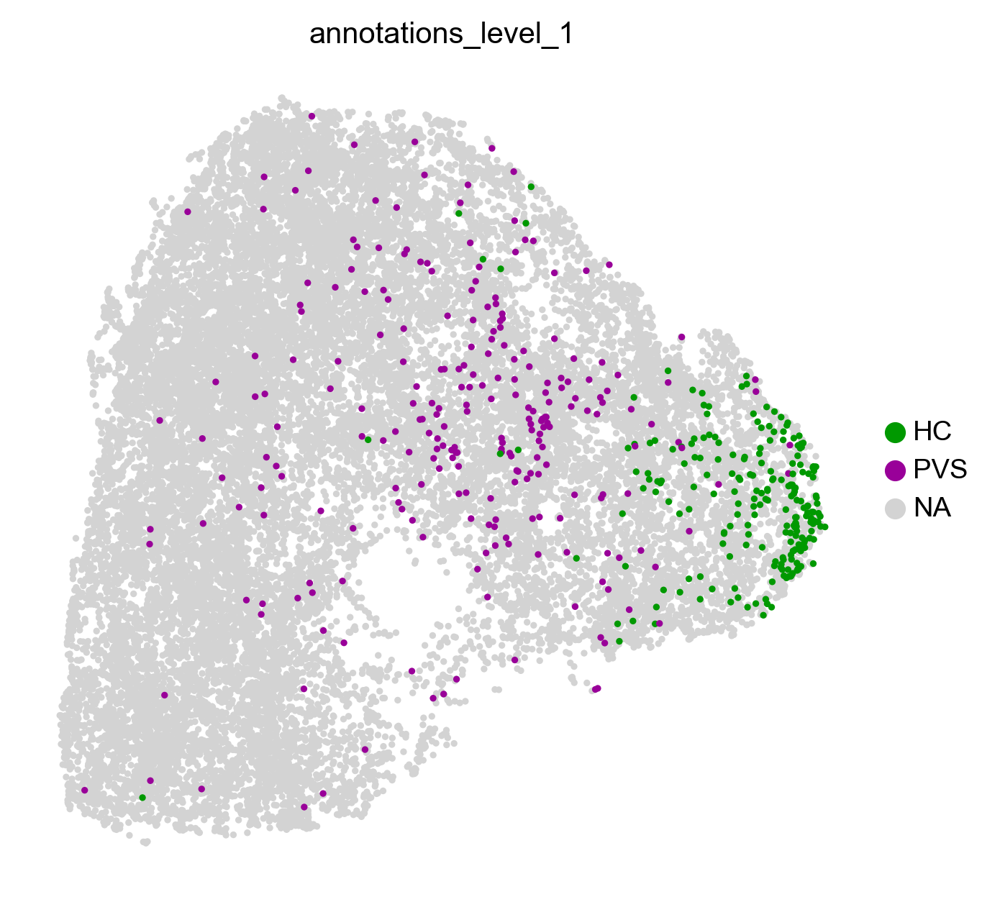

In [123]:
sc.pl.umap(adata_paed_filt, color = ['annotations_level_1']
           , frameon = False, groups=['HC','PVS'],s=20,save='_paed_annotations_level_1_v11.pdf')

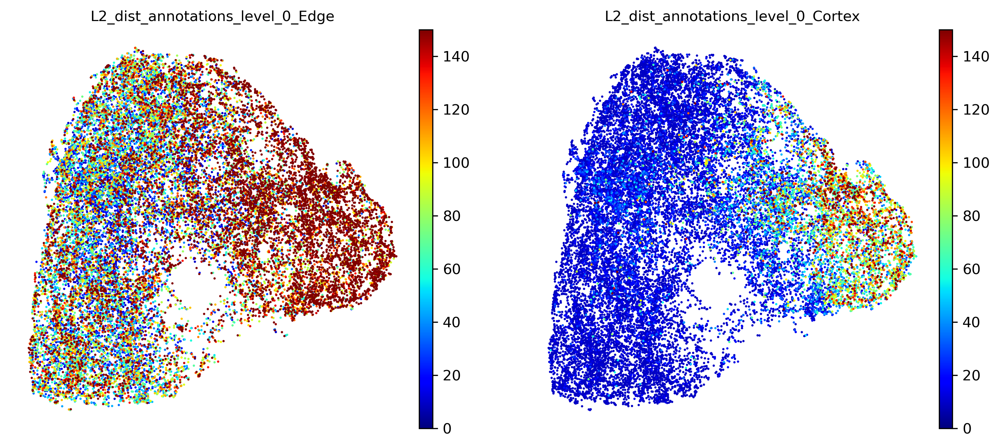

In [7]:
sc.set_figure_params(figsize=[5,5],fontsize=10,dpi=150)
sc.pl.umap(adata_paed_filt, color = ['L2_dist_annotations_level_0_Edge','L2_dist_annotations_level_0_Cortex'] # note that this distance needs to be multipied by 2 to get to microns
           , frameon = False, cmap = 'jet',vmin=0,vmax=150,save='_paed_dist_edge_cortex_300_v11.pdf',s=10)

In [125]:
sc.set_figure_params(figsize=[5,5],fontsize=10,dpi=150)
# sc.pl.umap(adata_paed_filt, color = ['cma_v2'],s=5, frameon = False, cmap = 'gist_rainbow',save='_paed_cma_v2_v11.pdf',vmin=-0.8,vmax=0.8)
# adata_paed_filt

In [3]:
import scanpy as sc
adata_paed_filt = sc.read_h5ad('')

# Analyse paed 

In [14]:
adata_paed_filt = sc.read_h5ad('')
adata_paed_filt.layers['counts'] = adata_paed_filt.X
adata_paed_filt
# make sure it's count data 
# list = ['CD34','NOTCH1','NOTCH2','NOTCH3',]
# sc.pl.violin(adata_paed_filt, keys =list,layer='counts')

In [15]:
# remove artifacts structures 
import warnings
warnings.filterwarnings('ignore')

adata_paed_cma = adata_paed_filt[adata_paed_filt.obs['annotations_level_1']!="Fat"].copy()

## remove meduala less lobules 
adata_paed_cma.obs['full_lobule'] = 0
for s in adata_paed_cma.obs['SampleID'].cat.categories.tolist():
    sample = adata_paed_cma[adata_paed_cma.obs['SampleID'].isin([s])]
    for l in sample.obs['annotations_lobules_0'].cat.categories:
        lobule = sample.obs['annotations_lobules_0'] == l
        med = np.where(sample.obs['annotations_level_0'][lobule] == 'Medulla')[0]
        cortex = np.where(sample.obs['annotations_level_0'][lobule] == 'Cortex')[0]
        if (cortex.size>=1) & (med.size>=1):
            adata_paed_cma.obs['full_lobule'][lobule.iloc[np.where(lobule)].index] = 1
adata_paed_cma.obs['full_lobule'] = adata_paed_cma.obs['full_lobule'].astype('category')
adata_paed_cma.obs['full_lobule'].value_counts()
adata_paed_cma = adata_paed_cma[adata_paed_cma.obs['full_lobule']==1] # remove spots that don't have either medullar or cortical data

sc.set_figure_params(figsize=[7,7],fontsize=20,dpi=100)
# sc.pl.umap(adata_paed_cma, color ='annotation_figure_1', frameon = False,s=5)

1    23258
0     2335
Name: full_lobule, dtype: int64

In [16]:
# normalize 
sc.pp.normalize_total(adata_paed_cma,target_sum=2500)
sc.pp.log1p(adata_paed_cma)
# adata_paed_cma

# correlations with axis 

In [17]:
# batch correction
sc.pp.combat(adata_paed_cma, key='SampleID', inplace=True)

Found 121 genes with zero variance.


In [18]:
# pca
sc.pp.pca(adata_paed_cma, n_comps = 10)

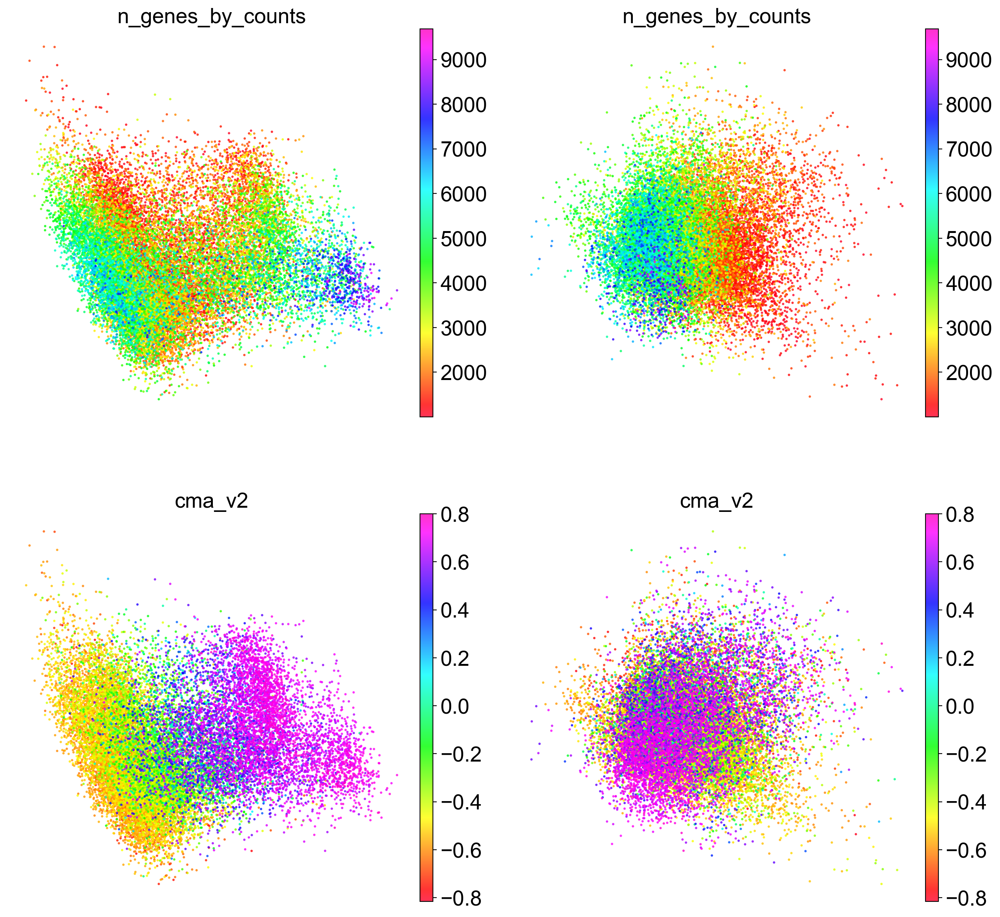

In [19]:
# plot pca 
sc.pl.pca(adata_paed_cma, components = ['1,2', '3,4'], color = ['n_genes_by_counts', 'cma_v2'], ncols = 2, cmap = "gist_rainbow",s=20,alpha=0.8,annotate_var_explained=True,frameon=False,save='_paed_pca_cma_counts_v11.pdf')

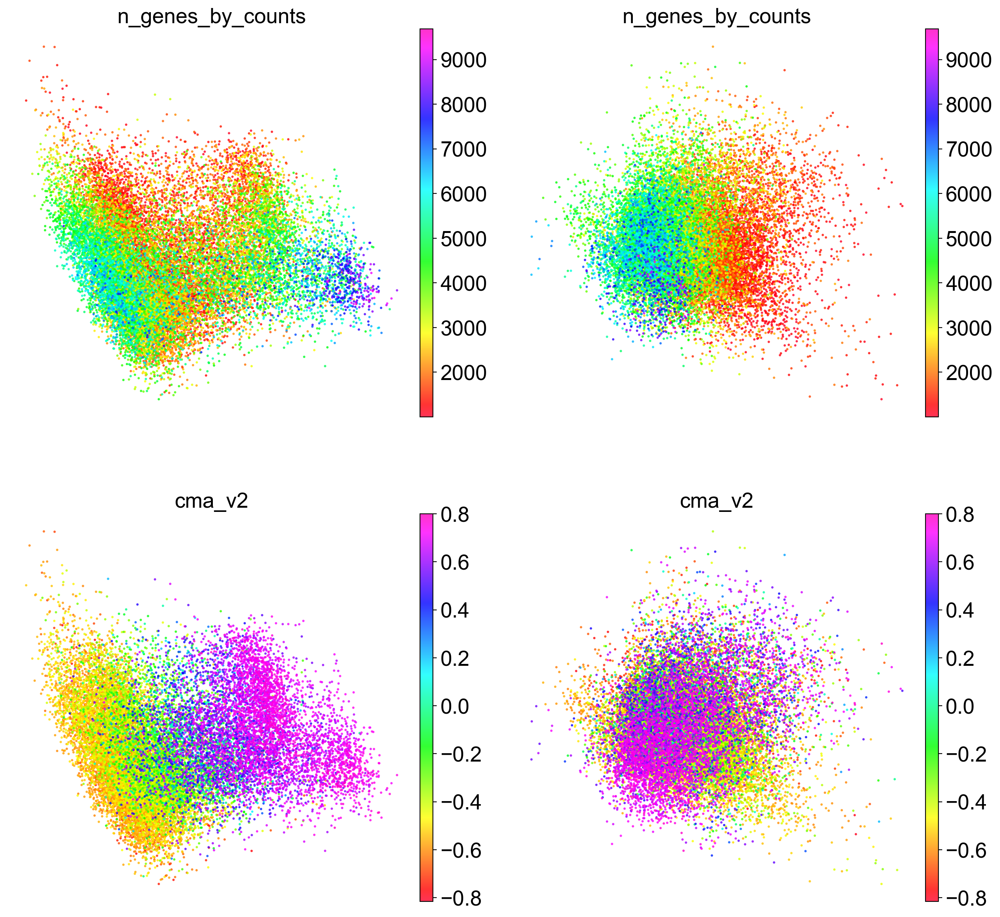

In [9]:
# plot pca 
sc.pl.pca(adata_paed_cma, components = ['1,2', '3,4'], color = ['n_genes_by_counts', 'cma_v2'], ncols = 2, cmap = "gist_rainbow",s=20,alpha=0.8,annotate_var_explained=True,frameon=False,save='_paed_pca_cma_counts_v11.pdf')

<BarContainer object of 10 artists>

<BarContainer object of 10 artists>

Text(0.5, 0, 'Number of PCs')

Text(0, 0.5, 'paed Cumulative Correlation as Percent of Cumulative Variance - cma')

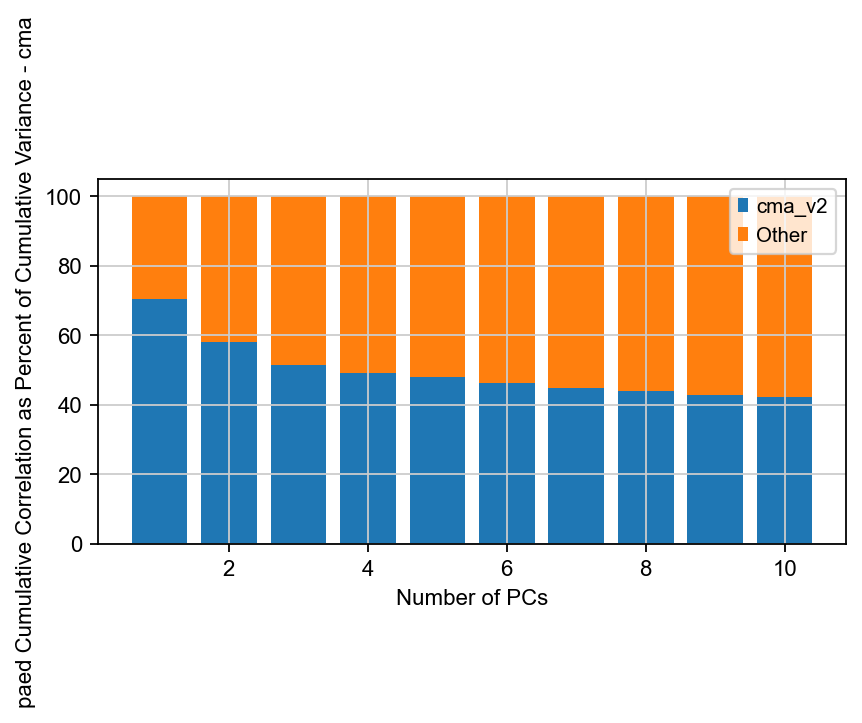

In [30]:
import matplotlib.pyplot as plt
from scipy.stats import spearmanr

sc.set_figure_params(figsize=[6,3],fontsize=10)

# Define the observation name
obs_name1 = "cma_v2"  # replace with your observation name

# Get the values of the observation
obs_values1 = adata_paed_cma.obs[obs_name1]

# Initialize variables to store the cumulative correlation and variance
cumulative_corr1 = 0
cumulative_variance = 0

# Initialize lists to store cumulative correlation as percent of cumulative variance
cum_corr_pct1 = []

# Calculate correlation with each PC
for i in range(10):
    pc_values = adata_paed_cma.obsm['X_pca'][:, i]

    # Pearson correlation
    corr1, _ = spearmanr(obs_values1, pc_values)

    # Get variance explained by this PC
    explained_variance = adata_paed_cma.uns['pca']['variance_ratio'][i]

    # Add weighted correlation and variance to cumulative measures
    cumulative_corr1 += np.abs(corr1) * explained_variance
    cumulative_variance += explained_variance

    # Store cumulative correlation as percent of cumulative variance
    cum_corr_pct1.append(100*cumulative_corr1/cumulative_variance)

# Create a stacked bar plot
plt.bar(range(1, 11), cum_corr_pct1, label=obs_name1)
plt.bar(range(1, 11), [100 - pct for pct in cum_corr_pct1], bottom=cum_corr_pct1, label='Other')
plt.xlabel('Number of PCs')
plt.ylabel('paed Cumulative Correlation as Percent of Cumulative Variance - cma')
plt.legend()

# Save the plot
# plt.savefig('figures/paed_cumulative_correlation_plot_v11.pdf', dpi=300)

plt.show()


In [35]:
coor = dict()
coor['cma'] = cum_corr_pct1

<BarContainer object of 10 artists>

<BarContainer object of 10 artists>

Text(0.5, 0, 'Number of PCs')

Text(0, 0.5, ' pael=d Cumulative Correlation as Percent of Cumulative Variance')

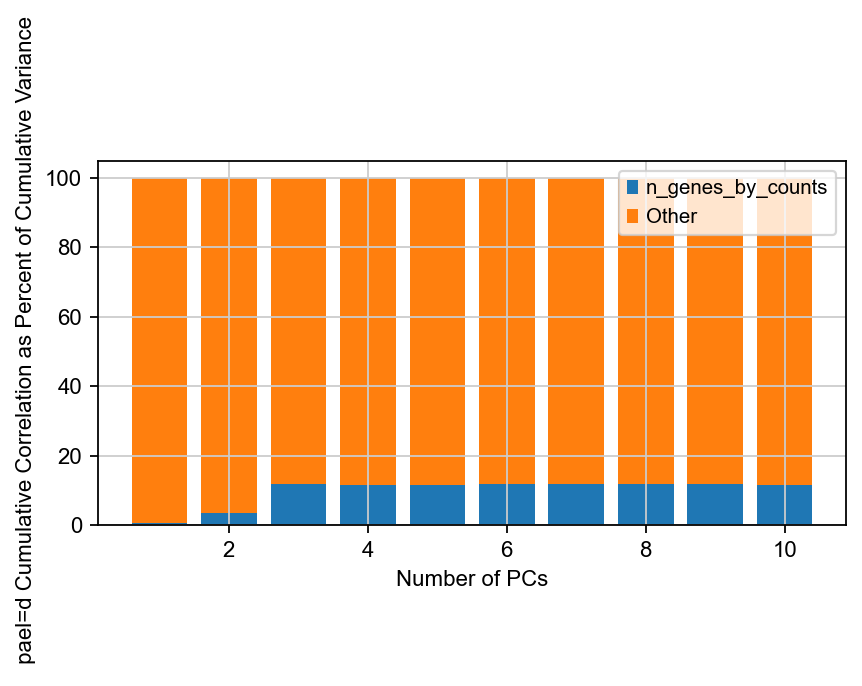

In [36]:
import matplotlib.pyplot as plt
from scipy.stats import spearmanr

sc.set_figure_params(figsize=[6,3],fontsize=10)
# Define the observation name
obs_name1 = "n_genes_by_counts"  # replace with your observation name

# Get the values of the observation
obs_values1 = adata_paed_cma.obs[obs_name1]

# Initialize variables to store the cumulative correlation and variance
cumulative_corr1 = 0
cumulative_variance = 0

# Initialize lists to store cumulative correlation as percent of cumulative variance
cum_corr_pct1 = []

# Calculate correlation with each PC
for i in range(10):
    pc_values = adata_paed_cma.obsm['X_pca'][:, i]

    # Pearson correlation
    corr1, _ = spearmanr(obs_values1, pc_values)

    # Get variance explained by this PC
    explained_variance = adata_paed_cma.uns['pca']['variance_ratio'][i]

    # Add weighted correlation and variance to cumulative measures
    cumulative_corr1 += np.abs(corr1) * explained_variance
    cumulative_variance += explained_variance

    # Store cumulative correlation as percent of cumulative variance
    cum_corr_pct1.append(100*cumulative_corr1/cumulative_variance)



# Create a stacked bar plot
plt.bar(range(1, 11), cum_corr_pct1, label=obs_name1)
plt.bar(range(1, 11), [100 - pct for pct in cum_corr_pct1], bottom=cum_corr_pct1, label='Other')

plt.xlabel('Number of PCs')
plt.ylabel(' pael=d Cumulative Correlation as Percent of Cumulative Variance')
plt.legend()

# Save the plot
# plt.savefig('figures/paed_cumulative_correlation_plot_genes_v11.pdf', dpi=300)

plt.show()


In [37]:
coor['n_genes_by_counts'] = cum_corr_pct1

In [41]:
pd.DataFrame(coor).to_csv('/nfs/team205/ny1/ThymusSpatialAtlas/SourceData/F2f_paed_vis_source.csv')

# save

In [14]:
adata_paed_cma.write_h5ad('/nfs/team205/ny1/ThymusSpatialAtlas/Figure_2_nat/visium_thymus_atlas_rev_v1_paed_cma.h5ad')